### Data loading

In [1]:
guppy_path = '../../OFT_pharmacology_guppy'
raw_path = '../../OFT_pharmacology'

In [2]:
guppy_path = '/Users/fsp585/Desktop/GetherLabCode/Openfield/OFT_pharmacology_guppy'
raw_path = '/Users/fsp585/Desktop/GetherLabCode/Openfield/OFT_pharmacology'

In [3]:
import os
import sys

parent_dir = os.path.abspath(os.path.join(os.getcwd(), os.pardir))
sys.path.append(parent_dir)

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from scipy import stats
import math
from scipy.signal import argrelextrema, find_peaks
from itertools import repeat, starmap

In [5]:
from processing.tracking_based_segmentation import *
from processing.segment_dfs import create_segment_dfs
from data.guppy_loading import create_all_z_score_dfs

In [6]:
# in the end we want the segments and the brain regions

In [7]:
# fetch z_scores
all_z_score_dfs = create_all_z_score_dfs(guppy_path)

In [8]:
all_z_score_dfs.keys()

dict_keys([('728', 'vs'), ('728', 'dls'), ('697', 'dls'), ('635', 'vs'), ('697', 'vs'), ('635', 'dls'), ('871', 'dls'), ('870', 'dls'), ('870', 'vs'), ('107', 'vs'), ('107', 'dls'), ('110', 'dls'), ('110', 'vs'), ('946', 'vs'), ('946', 'dls'), ('109', 'vs'), ('940', 'dls'), ('109', 'dls'), ('940', 'vs'), ('726', 'dls'), ('699', 'vs'), ('699', 'dls'), ('726', 'vs'), ('875', 'vs'), ('875', 'dls'), ('873', 'vs'), ('873', 'dls'), ('877', 'vs'), ('877', 'dls')])

In [9]:
# if we do tracking based segmentation
all_mouse_intervals_timestamps = process_mouse_data_from_path(raw_path)
all_mouse_segments = {k: nan_interval_to_segments(v) for k, v in all_mouse_intervals_timestamps.items()}

In [ ]:
segment_names = ['baseline', 'nicotine', 'antagonist']
all_segment_dfs = create_segment_dfs(segment_names, all_z_score_dfs, all_mouse_segments)

In [60]:
all_segment_dfs['baseline']

{('728',
  'vs'):            data   timestamps
 8502  -0.458040  1461.623488
 8503  -0.501135  1461.690144
 8504  -0.537467  1461.756800
 8505  -0.564625  1461.823456
 8506  -0.587156  1461.890144
 ...         ...          ...
 21997 -0.725396  2361.252448
 21998 -0.725542  2361.319136
 21999 -0.723935  2361.385792
 22000 -0.716167  2361.452448
 22001 -0.707235  2361.519104
 
 [13500 rows x 2 columns],
 ('728',
  'dls'):            data   timestamps
 8502  -0.206577  1461.623488
 8503  -0.403466  1461.690144
 8504  -0.447440  1461.756800
 8505  -0.472755  1461.823456
 8506  -0.320655  1461.890144
 ...         ...          ...
 21997 -0.396072  2361.252448
 21998 -0.264716  2361.319136
 21999 -0.135039  2361.385792
 22000 -0.048164  2361.452448
 22001 -0.100041  2361.519104
 
 [13500 rows x 2 columns],
 ('697',
  'dls'):            data    timestamps
 14006  0.134314   9804.519392
 14007  0.145782   9804.586048
 14008  0.046163   9804.652736
 14009 -0.068867   9804.719392
 14010 -0.2418

In [12]:
all_z_score_dfs.keys()

dict_keys([('728', 'vs'), ('728', 'dls'), ('697', 'dls'), ('635', 'vs'), ('697', 'vs'), ('635', 'dls'), ('871', 'dls'), ('870', 'dls'), ('870', 'vs'), ('107', 'vs'), ('107', 'dls'), ('110', 'dls'), ('110', 'vs'), ('946', 'vs'), ('946', 'dls'), ('109', 'vs'), ('940', 'dls'), ('109', 'dls'), ('940', 'vs'), ('726', 'dls'), ('699', 'vs'), ('699', 'dls'), ('726', 'vs'), ('875', 'vs'), ('875', 'dls'), ('873', 'vs'), ('873', 'dls'), ('877', 'vs'), ('877', 'dls')])

In [16]:
vs_signal = all_z_score_dfs[('728', 'vs')]['data']
ts = all_z_score_dfs[('728', 'vs')]['timestamps']

### Replication

In [18]:
def process_chunk(chunk, chunk_index, high_amp_filt, transients_thresh):
    chunk = chunk[~np.isnan(chunk)]
    median = np.median(chunk)
    mad = np.median(np.abs(chunk - median))
    
    first_threshold = median + (high_amp_filt * mad)
    
    filtered_out = chunk[chunk <= first_threshold]
    
    filtered_out_median = np.median(filtered_out)
    filtered_out_mad = np.median(np.abs(filtered_out - filtered_out_median))
    second_threshold = filtered_out_median + (transients_thresh * filtered_out_mad)
    
    greater_than_thresh_index = np.where(chunk > second_threshold)[0]
    temp = np.zeros(chunk.shape[0])
    temp[greater_than_thresh_index] = chunk[greater_than_thresh_index]
    peaks = argrelextrema(temp, np.greater)[0]
    
    return peaks + chunk_index[0], mad, filtered_out_mad, np.full(chunk.shape[0], median), np.full(chunk.shape[0], filtered_out_median), np.full(chunk.shape[0], first_threshold), np.full(chunk.shape[0], second_threshold)

def create_chunks(data, sampling_rate, window):
    window_points = math.ceil(sampling_rate * window)
    padding_size = (window_points - data.shape[0] % window_points) % window_points
    padded_data = np.pad(data, (0, padding_size), mode='constant', constant_values=np.nan)
    chunks = padded_data.reshape(-1, window_points)
    chunk_indices = np.arange(padded_data.shape[0]).reshape(-1, window_points)
    return chunks, chunk_indices

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from itertools import starmap, repeat

def visualize_peaks_and_mad(z_score, timestamps, high_amp_filt=2, transients_thresh=3, window=15):
    valid_indices = ~np.isnan(z_score)
    z_score = z_score[valid_indices]
    timestamps = timestamps[valid_indices]
    
    sampling_rate = (len(timestamps) - 1) / (timestamps[-1] - timestamps[0])
    
    z_score_chunks, z_score_chunks_index = create_chunks(z_score, sampling_rate, window)
    
    results = list(starmap(process_chunk, 
                           zip(z_score_chunks, 
                               z_score_chunks_index, 
                               repeat(high_amp_filt), 
                               repeat(transients_thresh))))
    
    all_peaks = np.concatenate([r[0] for r in results])
    all_peaks = all_peaks[all_peaks < len(z_score)]
    
    duration_minutes = (timestamps[-1] - timestamps[0]) / 60
    freq = all_peaks.shape[0] / duration_minutes
    #peak_amplitudes = z_score[all_peaks] - np.median([r[4][0] for r in results])
    
    # Calculate MAD for each chunk
    mad_values = [r[1] for r in results]
    chunk_timestamps = [timestamps[chunk_index[0]] for chunk_index in z_score_chunks_index]
    
    # Create subplots
    fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                        subplot_titles=('Z-score with Detected Peaks')) #, 'Median Absolute Deviation (MAD) over Time'))
    
    # Plot Z-score and peaks
    y_offset = np.median(z_score[:15*600])
    
    fig.add_trace(go.Scatter(x=timestamps, y=z_score - y_offset, mode='lines', name='Z-score'), row=1, col=1)
    fig.add_trace(go.Scatter(x=timestamps[all_peaks], y=z_score[all_peaks] - y_offset, mode='markers', name='Detected peaks', marker=dict(color='red', size=5)), row=1, col=1)
    
    # Plot MAD over time
    #fig.add_trace(go.Scatter(x=chunk_timestamps, y=mad_values, mode='lines', name='MAD', line=dict(color='blue')), row=2, col=1)
    
    # Update layout
    fig.update_layout(
        height=600, width=1200,
        title_text=f'Z-score with Detected Peaks', #<br>Frequency: {freq:.2f} events/min, Mean Amplitude: {np.mean(peak_amplitudes):.2f}',
        showlegend=True
    )
    
    fig.update_xaxes(title_text='Time', row=1, col=1)
    fig.update_yaxes(title_text='Z-score', row=1, col=1)
   #fig.update_yaxes(title_text='MAD', row=2, col=1)
    
    return fig

In [22]:
vs_signal.reset_index(drop=True)

0       -0.302662
1       -0.192141
2       -0.097377
3       -0.037687
4       -0.018781
           ...   
76460   -1.114253
76461   -1.110711
76462   -1.098419
76463   -1.082514
76464   -1.063009
Name: data, Length: 76465, dtype: float64

In [23]:
ts

2502     1061.639872
2503     1061.706560
2504     1061.773216
2505     1061.839872
2506     1061.906528
            ...     
78962    6158.760256
78963    6158.826944
78964    6158.893600
78965    6158.960256
78966    6159.026944
Name: timestamps, Length: 76465, dtype: float64

In [32]:
timestamps.iloc[-1]

6159.026944

In [33]:
z_score = vs_signal.reset_index(drop=True)  # Your z_score data
# z_score = mpfc_signal.reset_index(drop=True)  # Your z_score data
#timestamps = ts.reset_index(drop=True)  # Your timestamp data
timestamps = ts.to_numpy()
all_mouse_segments = ...  # Your mouse segments data (optional)
fig = visualize_peaks_and_mad(z_score, timestamps)
fig.show()  # This will open the plot in your default browser

### Fixed MAD peak detection

In [34]:
from numpy.lib.stride_tricks import sliding_window_view

In [ ]:
# vs_signal = mpfc_signal

In [35]:
windows = sliding_window_view(vs_signal, 225)
res = np.median(windows, axis=1)

In [36]:
print(len(vs_signal), len(res))

76465 76241


In [39]:
type(timestamps)

pandas.core.series.Series

In [43]:
vs_signal

2502    -0.302662
2503    -0.192141
2504    -0.097377
2505    -0.037687
2506    -0.018781
           ...   
78962   -1.114253
78963   -1.110711
78964   -1.098419
78965   -1.082514
78966   -1.063009
Name: data, Length: 76465, dtype: float64

In [51]:
def rolling_median(arr, window_size):
    windows = sliding_window_view(arr, window_size)
    median = np.nanmedian(windows, axis=1)
    padding = window_size // 2
    return np.pad(median, (padding, padding), mode='edge')

def process_z_score(z_score, window_size, high_amp_filt, transients_thresh):
    # Remove NaN values
    valid_indices = ~np.isnan(z_score)
    z_score = z_score[valid_indices]

    # Calculate rolling median
    rolling_median_values = rolling_median(z_score, window_size)

    # Calculate MAD
    abs_deviation = np.abs(z_score - rolling_median_values)
    mad = rolling_median(abs_deviation, window_size)

    # Calculate first threshold
    first_threshold = rolling_median_values + (high_amp_filt * mad)
    
    # Calculate second threshold
    filtered_out = np.where(z_score <= first_threshold, z_score, np.nan)
    
    filtered_out_median = rolling_median(filtered_out, window_size)
    filtered_out_abs_deviation = np.abs(filtered_out - filtered_out_median)
    filtered_out_mad = rolling_median(filtered_out_abs_deviation, window_size)
    second_threshold = filtered_out_median + (transients_thresh * filtered_out_mad)
    
    # Detect peaks
    greater_than_thresh_index = np.where(z_score > second_threshold)[0]
    temp = np.zeros(z_score.shape[0])
    temp[greater_than_thresh_index] = z_score[greater_than_thresh_index]
    peaks = argrelextrema(temp, np.greater)[0]
    
    print(len(peaks))
    return peaks, mad, filtered_out_mad, rolling_median_values, filtered_out_median, first_threshold, second_threshold


import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

def visualize_peaks_and_mad(z_score, timestamps, high_amp_filt=2, transients_thresh=3, window=225):
    valid_indices = ~np.isnan(z_score)
    z_score = z_score.loc[valid_indices]
    timestamps = timestamps.loc[valid_indices]
    
    # Process z_score data
    peaks, mad, filtered_out_mad, rolling_median_values, filtered_out_median, first_threshold, second_threshold = process_z_score(z_score, window, high_amp_filt, transients_thresh)
    
    # Calculate frequency and amplitude of peaks
    duration_minutes = (timestamps.iloc[-1] - timestamps.iloc[0]) / 60
    freq = peaks.shape[0] / duration_minutes
    peak_amplitudes = z_score[peaks] - rolling_median_values[peaks]
    
    # Create subplots
    fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                        subplot_titles=('Z-score with Detected Peaks', 'Rolling MAD over Time'))
    
    # Plot Z-score and peaks
    y_offset = np.median(z_score[:min(15*600, len(z_score))])
    fig.add_trace(go.Scatter(x=timestamps, y=z_score - y_offset, mode='lines', opacity=0.4, name='Z-score'), row=1, col=1)
    fig.add_trace(go.Scatter(x=timestamps[peaks], y=z_score[peaks] - y_offset, mode='markers', name='Detected peaks', marker=dict(color='red', size=5)), row=1, col=1)
    fig.add_trace(go.Scatter(x=timestamps, y=first_threshold - y_offset, mode='lines', name='First threshold', line=dict(color='green', dash='dash')), row=1, col=1)
    fig.add_trace(go.Scatter(x=timestamps, y=second_threshold - y_offset, mode='lines', name='Peak threshold', line=dict(color='orange')), row=1, col=1)
    fig.add_trace(go.Scatter(x=timestamps, y=rolling_median_values - y_offset, mode='lines', name='rolling median', line=dict(color='green')), row=1, col=1)
    
    # Plot MAD over time
    #fig.add_trace(go.Scatter(x=timestamps, y=mad, mode='lines', name='Rolling MAD', line=dict(color='blue')), row=2, col=1)
    
    # Update layout
    fig.update_layout(
        height=800, width=1600,
        title_text=f'Z-score with Detected Peaks',
        showlegend=True
    )
    
    fig.update_xaxes(title_text='Time', row=1, col=1)
    fig.update_yaxes(title_text='Z-score', row=1, col=1)
    #fig.update_yaxes(title_text='MAD', row=2, col=1)
    
    return fig

z_score = vs_signal.reset_index(drop=True)  # Your z_score data
timestamps = ts.reset_index(drop=True)  # Your timestamp data
fig = visualize_peaks_and_mad(z_score, timestamps)
fig.show()  # This will open the plot in your default browser

1026


### Baseline mean MAD

In [70]:
#trying using fixed avg mad

def rolling_median(arr, window_size):
    windows = sliding_window_view(arr, window_size)
    median = np.nanmedian(windows, axis=1)
    padding = window_size // 2
    return np.pad(median, (padding, padding), mode='edge')

def process_z_score(z_score, window_size, high_amp_filt, transients_thresh):
    # Remove NaN values
    valid_indices = ~np.isnan(z_score)
    z_score = z_score.loc[valid_indices]

    # Calculate rolling median
    rolling_median_values = rolling_median(z_score, window_size)

    # Calculate MAD
    abs_deviation = np.abs(z_score - rolling_median_values)
    mad = rolling_median(abs_deviation, window_size)

    # Calculate first threshold
    first_threshold = rolling_median_values + (high_amp_filt * mad)
    
    # Calculate second threshold
    filtered_out = np.where(z_score <= first_threshold, z_score, np.nan)
    
    filtered_out_median = rolling_median(filtered_out, window_size)
    filtered_out_abs_deviation = np.abs(filtered_out - filtered_out_median)
    filtered_out_mad = rolling_median(filtered_out_abs_deviation, window_size)
    baseline_avg_mad = np.average(filtered_out_mad[:1000*20])
    second_threshold = filtered_out_median + (transients_thresh * baseline_avg_mad)
    
    # Detect peaks
    greater_than_thresh_index = np.where(z_score > second_threshold)[0]
    temp = np.zeros(z_score.shape[0])
    temp[greater_than_thresh_index] = z_score[greater_than_thresh_index]
    peaks = argrelextrema(temp, np.greater)[0]
    
    return peaks, mad, baseline_avg_mad, rolling_median_values, filtered_out_median, first_threshold, second_threshold


import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

def visualize_peaks_and_mad(z_score, timestamps, high_amp_filt=2, transients_thresh=3, window=225):
    valid_indices = ~np.isnan(z_score)
    z_score = z_score.loc[valid_indices]
    timestamps = timestamps.loc[valid_indices]
    timestamps -= timestamps.iloc[0]
    
    # Process z_score data
    peaks, mad, baseline_avg_mad, rolling_median_values, filtered_out_median, first_threshold, second_threshold = process_z_score(z_score, window, high_amp_filt, transients_thresh)
    
    # Calculate frequency and amplitude of peaks
    duration_minutes = (timestamps.iloc[-1] - timestamps.iloc[0]) / 60
    freq = peaks.shape[0] / duration_minutes
    peak_amplitudes = z_score[peaks] - rolling_median_values[peaks]
    
    # Create subplots
    fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                        subplot_titles=('Z-score with Detected Peaks', 'Rolling MAD over Time'))
    
    # Plot Z-score and peaks
    y_offset = np.median(z_score[:min(15*600, len(z_score))])
    fig.add_trace(go.Scatter(x=timestamps, y=z_score - y_offset, mode='lines', opacity=0.4, name='Z-score'), row=1, col=1)
    fig.add_trace(go.Scatter(x=timestamps[peaks], y=z_score[peaks] - y_offset, mode='markers', name='Detected peaks', marker=dict(color='red', size=5)), row=1, col=1)
    #fig.add_trace(go.Scatter(x=timestamps, y=first_threshold - y_offset, mode='lines', name='First threshold', line=dict(color='green', dash='dash')), row=1, col=1)
    fig.add_trace(go.Scatter(x=timestamps, y=second_threshold - y_offset, mode='lines', name='Peak threshold', line=dict(color='orange')), row=1, col=1)
    fig.add_trace(go.Scatter(x=timestamps, y=rolling_median_values - y_offset, mode='lines', name='rolling median', line=dict(color='green')), row=1, col=1)

    
    # Plot MAD over time
    #fig.add_trace(go.Scatter(x=timestamps, y=mad, mode='lines', name='Rolling MAD', line=dict(color='blue')), row=2, col=1)
    
    # Update layout
    fig.update_layout(
        height=800, width=1600,
        title_text=f'Z-score with Detected Peaks<br>Frequency: {freq:.2f} events/min, Mean Amplitude: {np.mean(peak_amplitudes):.2f}',
        showlegend=True
    )
    
    fig.update_xaxes(title_text='Time', row=1, col=1)
    fig.update_yaxes(title_text='Z-score', row=1, col=1)
    #fig.update_yaxes(title_text='MAD', row=2, col=1)
    
    return fig

z_score = vs_signal.reset_index(drop=True)  # Your z_score data
timestamps = ts.reset_index(drop=True)  # Your timestamp data
fig = visualize_peaks_and_mad(z_score, timestamps)
fig.show()  # This will open the plot in your default browser

In [71]:
def extract_peak_statistics(z_score, timestamps, high_amp_filt=2, transients_thresh=3, window=225):
    valid_indices = ~np.isnan(z_score)
    z_score = z_score.loc[valid_indices]
    timestamps = timestamps.loc[valid_indices]
    timestamps -= timestamps.iloc[0]
    
    # Process z_score data
    peaks, mad, baseline_avg_mad, rolling_median_values, filtered_out_median, first_threshold, second_threshold = process_z_score(z_score, window, high_amp_filt, transients_thresh)
    
    # Calculate frequency and amplitude of peaks
    duration_minutes = (timestamps.iloc[-1] - timestamps.iloc[0]) / 60
    freq = peaks.shape[0] / duration_minutes
    peak_amplitudes = z_score[peaks] - rolling_median_values[peaks]
        
    # Plot Z-score and peaks
    y_offset = np.median(z_score[:min(15*600, len(z_score))])
    
    # Plot MAD over time
    #fig.add_trace(go.Scatter(x=timestamps, y=mad, mode='lines', name='Rolling MAD', line=dict(color='blue')), row=2, col=1)
    
    return freq, peak_amplitudes

# z_score = vs_signal.reset_index(drop=True)  # Your z_score data
# timestamps = ts.reset_index(drop=True)  # Your timestamp data

# fig = visualize_peaks_and_mad(z_score, timestamps)
# fig.show()  # This will open the plot in your default browser

In [ ]:
from collections import defaultdict

# Storage for results
region_statistics = defaultdict(lambda: defaultdict(lambda: defaultdict(list)))  # Nested dict for genotype and segments
wt_ids = [109, 944, 940, 873, 699, 106, 935, 728, 697]
ko_ids = [110, 946, 877, 875, 635, 107, 105, 938, 871, 870]
genotype_ids = {'wt': wt_ids, 'ko': ko_ids}

# Iterate over all segment names
for segment_name in segment_names:
    # Iterate over all mice and brain regions
    for (mouse_id, brain_region), signal_df in all_segment_dfs[segment_name].items():
        if mouse_id in ['635', '697']:  # Skip specific mice
            continue
        
        signal = signal_df['data'].reset_index(drop=True)
        timestamps = signal_df['timestamps'].reset_index(drop=True)
        freq, peak_amplitudes = extract_peak_statistics(signal, timestamps)
        
        # Determine genotype
        mouse_int = int(mouse_id)
        genotype = 'wt' if mouse_int in genotype_ids['wt'] else 'ko' if mouse_int in genotype_ids['ko'] else None
        if genotype is None:
            continue  # Skip if genotype is not defined
        
        # Store data grouped by brain region, genotype, and segment name
        region_statistics[brain_region][genotype][segment_name].append({
            'mouse_id': mouse_id,
            'median_peak_amplitude': np.median(peak_amplitudes),
            'mean_peak_amplitude': np.mean(peak_amplitudes),
            'freq': freq
        })

# Create a DataFrame to summarize statistics for each brain region, genotype, and segment name
summary_stats = []
for brain_region, genotype_data in region_statistics.items():
    for genotype, segment_data in genotype_data.items():
        for segment_name, stats in segment_data.items():
            median_peaks = [s['median_peak_amplitude'] for s in stats]
            mean_peaks = [s['mean_peak_amplitude'] for s in stats]
            freqs = [s['freq'] for s in stats]
            
            summary_stats.append({
                'segment_name': segment_name,
                'brain_region': brain_region,
                'genotype': genotype,
                'median_peak_amplitude': f"{np.mean(median_peaks):.2f} ± {np.std(median_peaks):.2f}",
                'mean_peak_amplitude': f"{np.mean(mean_peaks):.2f} ± {np.std(mean_peaks):.2f}",
                'freq': f"{np.mean(freqs):.2f} ± {np.std(freqs):.2f}"
            })

summary_df = pd.DataFrame(summary_stats)


In [89]:
summary_df

,segment_name,brain_region,genotype,median_peak_amplitude,mean_peak_amplitude,freq,median_peak_amplitude_mean,median_peak_amplitude_std,mean_peak_amplitude_mean,mean_peak_amplitude_std,freq_mean,freq_std
0,baseline,vs,wt,0.56 ± 0.16,0.64 ± 0.17,12.72 ± 1.15,0.56,0.16,0.64,0.17,12.72,1.15
1,nicotine,vs,wt,0.94 ± 0.13,1.08 ± 0.14,9.30 ± 1.37,0.94,0.13,1.08,0.14,9.30,1.37
2,antagonist,vs,wt,0.53 ± 0.15,0.63 ± 0.17,8.93 ± 1.47,0.53,0.15,0.63,0.17,8.93,1.47
3,baseline,vs,ko,0.77 ± 0.21,0.90 ± 0.21,11.37 ± 2.92,0.77,0.21,0.90,0.21,11.37,2.92
4,nicotine,vs,ko,1.13 ± 0.28,1.31 ± 0.37,11.07 ± 2.85,1.13,0.28,1.31,0.37,11.07,2.85
5,antagonist,vs,ko,0.69 ± 0.20,0.81 ± 0.25,8.70 ± 1.48,0.69,0.20,0.81,0.25,8.70,1.48
6,baseline,dls,wt,1.16 ± 0.31,1.24 ± 0.31,13.72 ± 2.41,1.16,0.31,1.24,0.31,13.72,2.41
7,nicotine,dls,wt,1.14 ± 0.24,1.24 ± 0.24,10.71 ± 0.75,1.14,0.24,1.24,0.24,10.71,0.75
8,antagonist,dls,wt,0.83 ± 0.17,0.90 ± 0.20,9.28 ± 2.32,0.83,0.17,0.90,0.20,9.28,2.32
9,baseline,dls,ko,1.04 ± 0.31,1.13 ± 0.34,13.23 ± 2.48,1.04,0.31,1.13,0.34,13.23,2.48


In [93]:
import seaborn as sns

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



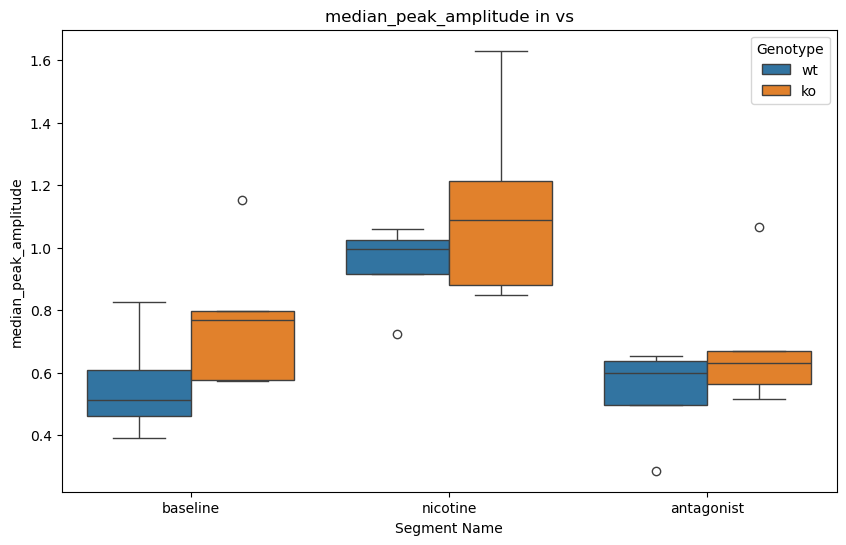

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



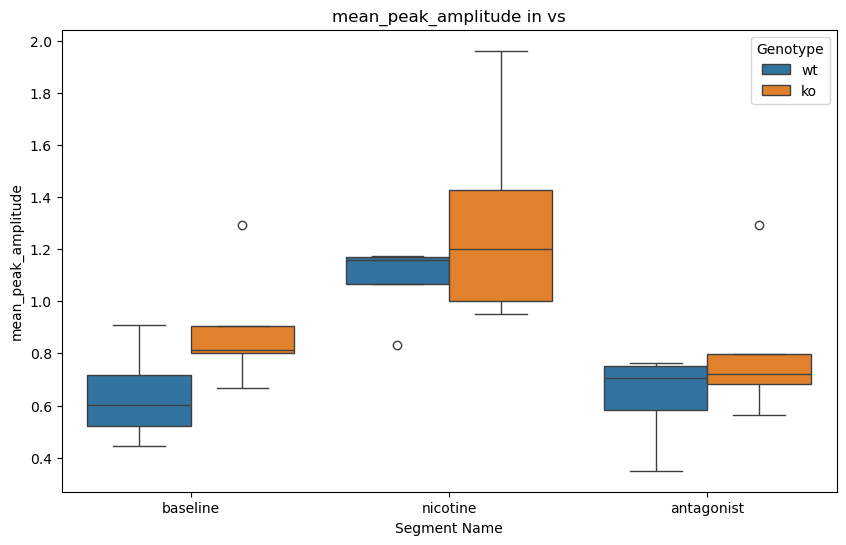

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



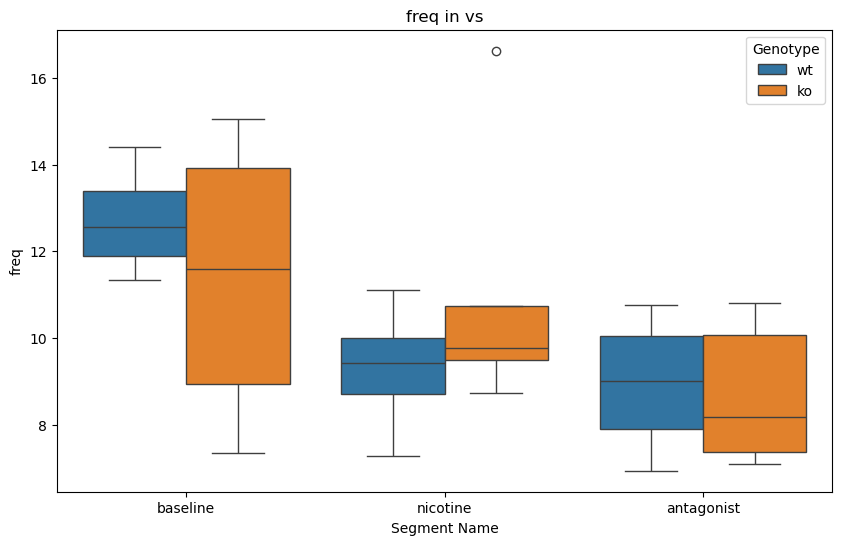

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



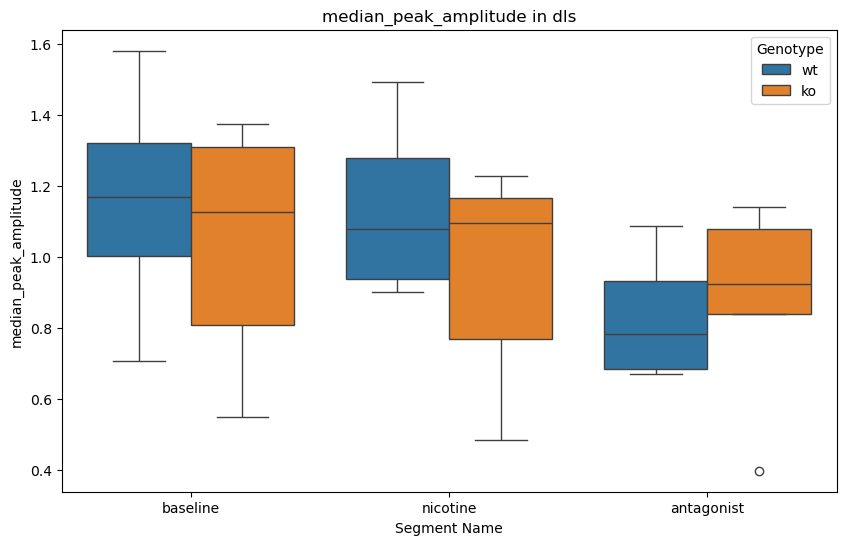

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



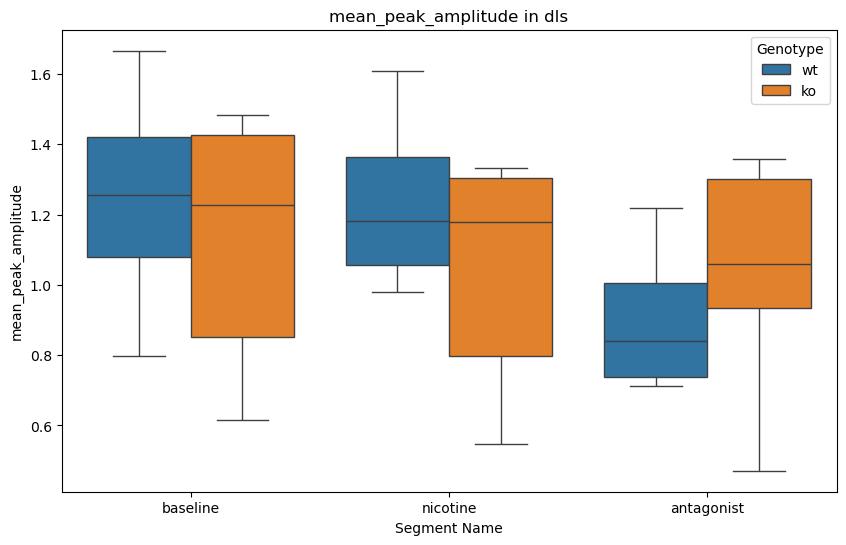

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/_base.py:948: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/fsp585/anaconda3/envs/sund/lib/python3.11/site-packages/seaborn/categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



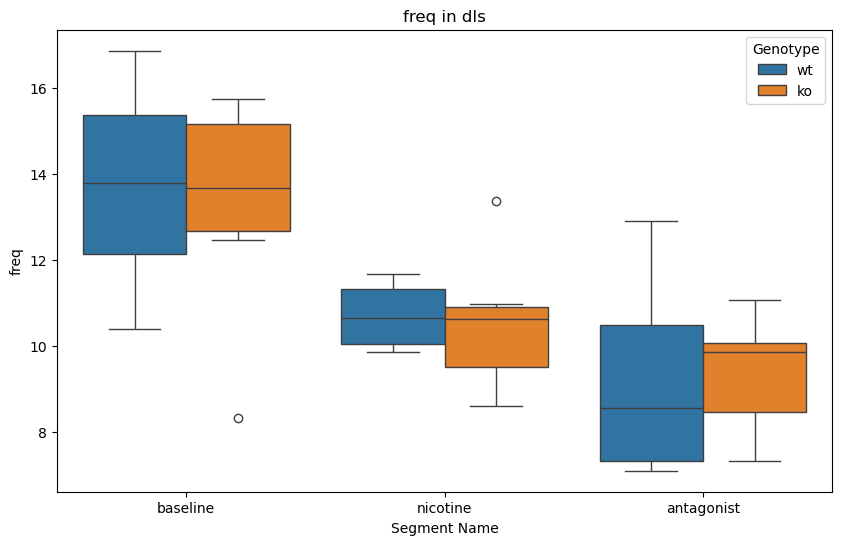

In [97]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Extract data from region_statistics into a DataFrame
data_list = []

for brain_region, genotype_data in region_statistics.items():
    for genotype, segment_data in genotype_data.items():
        for segment_name, stats in segment_data.items():
            for stat in stats:
                data_list.append({
                    'mouse_id': stat['mouse_id'],
                    'brain_region': brain_region,
                    'genotype': genotype,
                    'segment_name': segment_name,
                    'median_peak_amplitude': stat['median_peak_amplitude'],
                    'mean_peak_amplitude': stat['mean_peak_amplitude'],
                    'freq': stat['freq']
                })

# Create a DataFrame from the data list
raw_df = pd.DataFrame(data_list)

# Now, create boxplots for each combination of brain region and metric
metrics = ['median_peak_amplitude', 'mean_peak_amplitude', 'freq']

for brain_region in raw_df['brain_region'].unique():
    df_brain = raw_df[raw_df['brain_region'] == brain_region]
    for metric in metrics:
        plt.figure(figsize=(10, 6))
        sns.boxplot(data=df_brain, x='segment_name', y=metric, hue='genotype')
        plt.title(f'{metric} in {brain_region}')
        plt.ylabel(metric)
        plt.xlabel('Segment Name')
        plt.legend(title='Genotype')
        plt.show()
